# Analysis of Layer Integrated Gradients Attributions


TODOS:
- fix viz html to png
- analyze what role position plays, any correls with attribution? esp. start / end
(not that important actually)
- tf idf vectorizer
df
max 0.124 min 3 

## Imports, read & clean up data

In [1]:
import ast
import matplotlib.pyplot as plt
import os
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from captum.attr import visualization as viz
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm

from _stop_words import ENGLISH_STOP_WORDS

%matplotlib inline

In [2]:
# convert strings into lists
def literal_eval_column(column):
    try:
        return ast.literal_eval(column)
    except (SyntaxError, ValueError):
        return column


def read_dfs(directory):
    dataframes = []

    for filename in os.listdir(directory):
        if filename.endswith('.csv'):  # check if the file is a CSV file
            file_path = os.path.join(directory, filename)
            df = pd.read_csv(file_path)
            dataframes.append(df)

    # merge the DataFrames into a single DataFrame
    merged_df = pd.concat(dataframes, ignore_index=True)
    pd.set_option('display.max_colwidth', None)
    merged_df = merged_df.applymap(literal_eval_column)
    return merged_df

# check erroneous indices 
with open('nohup-att-dist4.out', 'r', encoding='utf-8') as f:
    lines = f.readlines()
error_indices = [int(l.split(' ')[0]) for l in lines[7:] if l]

gold = pd.read_csv('outputs/20newsgroups_test.csv', encoding='utf-8')
# exclude erroneous lines
gold = gold[~gold.index.isin(error_indices)]
gold = gold.reset_index()

def compare_pred(row):
    return 1 if row['label_pred'] == gold['label_text'][row.index] else 0

def postprocess(merged_df, whole_ds=True):
    """filter and compare to gold labels"""
    # exclude nan rows
    filtered = merged_df.dropna(subset='tokens')
    filtered = filtered.reset_index()
    # create gold label column
    filtered['label_gold'] = gold['label_text']
    filtered['correct'] = filtered.label_gold == filtered.label_pred
    # sum up attributions for a sentence
    filtered['sum_attributions'] = filtered['attributions'].apply(lambda x: sum(x) if isinstance(x, list) else None)
    filtered['mean_attributions'] = filtered['attributions'].apply(lambda x: np.mean(x) if isinstance(x, list) else None)
    filtered = filtered.drop(columns=['0', 'Unnamed: 0'])
    if whole_ds:  # not for subset of the dataset
        assert len(gold) == len(filtered)
    return filtered

In [4]:
merged_df_gold = read_dfs(directory='outputs/distilbert/gold/')
filtered_gold = postprocess(merged_df_gold)
len(filtered_gold)

7309

In [5]:
merged_df = read_dfs(directory='outputs/distilbert/pred/')
filtered = postprocess(merged_df)
# 215 empty strings in data, also some only one-char instances
len(filtered)

7309

In [14]:
merged_df = filtered.merge(filtered_gold, left_index=True, right_index=True, suffixes=('', '_gold'))

In [10]:
merged_df.columns

Index(['index', 'attributions', 'label_pred', 'score', 'tokens', 'label_gold',
       'correct', 'sum_attributions', 'mean_attributions', 'index_gold',
       'attributions_gold', 'label_pred_gold', 'score_gold', 'tokens_gold',
       'label_gold_gold', 'correct_gold', 'sum_attributions_gold',
       'mean_attributions_gold'],
      dtype='object')

In [15]:
merged_df = merged_df.drop(columns=['label_pred_gold', 'score_gold', 'tokens_gold', 'label_gold_gold', 'correct_gold', 'index_gold'])
merged_df = merged_df.rename(columns={'attributions': 'attributions_pred',
                                      'sum_attributions': 'sum_attributions_pred',
                                      'mean_attributions': 'mean_attributions_pred',
                                      })

In [16]:
merged_df.head()

,index,attributions_pred,label_pred,score,tokens,label_gold,correct,sum_attributions_pred,mean_attributions_pred,attributions_gold,sum_attributions_gold,mean_attributions_gold
0,0,"[-0.011615987537462793, 0.003815996398574733, -0.02191897198284099, 0.00353599154760804, 0.004261144208178493, -0.02503160729747406, 0.0058729188810844974, 0.007999395991943051, 0.012723196000410034, 0.08260929763908878, -0.010398286875429175, -0.046741547448048766, 0.3027173206240339, -0.05100008408213716, -0.06549745985136265, 0.38428367756921933, 0.7321146562954034, -0.07499692442814013, 0.016203011386595374, 0.004961789917535488, 0.025508618986595885, 0.011765683720096386, -0.016225424175402865, -0.013104757773216135, 0.035638924404262584, 0.012670462054776897, 0.04288821188265225, -0.00789026094350954, 0.0018219250703898804, -0.006981559104691794, -0.0023377363449687844, 0.034412943479448545, -0.006077524600938549, 0.0046385209154211115, 0.0064171634112067605, 0.01645907792812186, 0.011146396008513094, -0.012440158854074295, 0.009950708162844282, 0.012414307830362648, 1.3212852153343242e-05, -0.006331832376639634, 0.047747462973731974, -0.018985067368052853, 0.12988321189041413, -0.011812421531554184, 0.0047154813689010144, 0.020369756668034228, 0.00306223513850506, 0.008969242258443434, -0.01273253759336235, -0.0011216658364127676, 0.007698334438858589, -0.013072872394666474, 0.058075750922201304, 0.019793177844054332, -0.005472117694038411, 0.019468579339931676, 0.0006701972403216481, -0.003632494297984114, 0.005277701531667401, 0.01015247643493258, 0.1170323622792394, 0.09309963321459896, -0.03250638064396868, -0.004283330137682506, -0.003558761607872941, 0.004445077230500035, 0.006080096612406869, 0.002200150785567924, 0.07924498003546944, 0.07272083881968712, 0.007525302893132537, 0.021239717668123645, 0.0013719403212904854, 0.021162795755037635, 0.01754352921600174, 0.0018729709836661764, 0.00019161348083319144, -0.0008662934894531147, -0.0017040674046419524, -5.766808527910764e-05, 0.012096173817672867, -0.003913778298512972, 0.009564579720686809, 0.004383091644874691, -0.0011632482183782673, 0.02628201621528978, -0.0005141407757770322, 0.011406592282767532, 0.0030941646376057602, 0.0376145558343233, 0.002903052020059903, 0.0031795917496801065, 0.00881902663574049, 0.010772759570629464, -0.004213699769513332, -0.012217965717800781, -0.004513847465023962, -0.0052423352888649796, ...]",rec.autos,0.801348,"[i, am, a, little, confused, on, all, of, the, models, of, the, 88, -, 89, bonn, ##eville, ##s, ., i, have, heard, of, the, le, se, l, ##se, ss, ##e, ss, ##ei, ., could, someone, tell, me, the, differences, are, far, as, features, or, performance, ., i, am, also, curious, to, know, what, the, book, value, is, for, prefer, ##ea, ##bly, the, 89, model, ., and, how, much, less, than, book, value, can, you, usually, get, them, for, ., in, other, words, how, much, are, they, in, demand, this, time, of, year, ., i, have, heard, that, the, mid, -, ...]",rec.autos,True,2.790767,0.025371,"[-0.011615987537462793, 0.003815996398574733, -0.02191897198284099, 0.00353599154760804, 0.004261144208178493, -0.02503160729747406, 0.0058729188810844974, 0.007999395991943051, 0.012723196000410034, 0.08260929763908878, -0.010398286875429175, -0.046741547448048766, 0.3027173206240339, -0.05100008408213716, -0.06549745985136265, 0.38428367756921933, 0.7321146562954034, -0.07499692442814013, 0.016203011386595374, 0.004961789917535488, 0.025508618986595885, 0.011765683720096386, -0.016225424175402865, -0.013104757773216135, 0.035638924404262584, 0.012670462054776897, 0.04288821188265225, -0.00789026094350954, 0.0018219250703898804, -0.006981559104691794, -0.0023377363449687844, 0.034412943479448545, -0.006077524600938549, 0.0046385209154211115, 0.0064171634112067605, 0.01645907792812186, 0.011146396008513094, -0.012440158854074295, 0.009950708162844282, 0.012414307830362648, 1.3212852153343242e-05, -0.006331832376639634, 0.047747462973731974, -0.018985067368052853,

In [18]:
merged_df.to_csv('outputs/distilbert_attributions.csv', encoding='utf-8')

#### Glance into data frame

In [50]:
filtered.head()

,index,attributions,label_pred,score,tokens,label_gold,correct,sum_attributions
0,0,"[-0.011615987537462793, 0.003815996398574733, -0.02191897198284099, 0.00353599154760804, 0.004261144208178493, -0.02503160729747406, 0.0058729188810844974, 0.007999395991943051, 0.012723196000410034, 0.08260929763908878, -0.010398286875429175, -0.046741547448048766, 0.3027173206240339, -0.05100008408213716, -0.06549745985136265, 0.38428367756921933, 0.7321146562954034, -0.07499692442814013, 0.016203011386595374, 0.004961789917535488, 0.025508618986595885, 0.011765683720096386, -0.016225424175402865, -0.013104757773216135, 0.035638924404262584, 0.012670462054776897, 0.04288821188265225, -0.00789026094350954, 0.0018219250703898804, -0.006981559104691794, -0.0023377363449687844, 0.034412943479448545, -0.006077524600938549, 0.0046385209154211115, 0.0064171634112067605, 0.01645907792812186, 0.011146396008513094, -0.012440158854074295, 0.009950708162844282, 0.012414307830362648, 1.3212852153343242e-05, -0.006331832376639634, 0.047747462973731974, -0.018985067368052853, 0.12988321189041413, -0.011812421531554184, 0.0047154813689010144, 0.020369756668034228, 0.00306223513850506, 0.008969242258443434, -0.01273253759336235, -0.0011216658364127676, 0.007698334438858589, -0.013072872394666474, 0.058075750922201304, 0.019793177844054332, -0.005472117694038411, 0.019468579339931676, 0.0006701972403216481, -0.003632494297984114, 0.005277701531667401, 0.01015247643493258, 0.1170323622792394, 0.09309963321459896, -0.03250638064396868, -0.004283330137682506, -0.003558761607872941, 0.004445077230500035, 0.006080096612406869, 0.002200150785567924, 0.07924498003546944, 0.07272083881968712, 0.007525302893132537, 0.021239717668123645, 0.0013719403212904854, 0.021162795755037635, 0.01754352921600174, 0.0018729709836661764, 0.00019161348083319144, -0.0008662934894531147, -0.0017040674046419524, -5.766808527910764e-05, 0.012096173817672867, -0.003913778298512972, 0.009564579720686809, 0.004383091644874691, -0.0011632482183782673, 0.02628201621528978, -0.0005141407757770322, 0.011406592282767532, 0.0030941646376057602, 0.0376145558343233, 0.002903052020059903, 0.0031795917496801065, 0.00881902663574049, 0.010772759570629464, -0.004213699769513332, -0.012217965717800781, -0.004513847465023962, -0.0052423352888649796, ...]",rec.autos,0.801348,"[i, am, a, little, confused, on, all, of, the, models, of, the, 88, -, 89, bonn, ##eville, ##s, ., i, have, heard, of, the, le, se, l, ##se, ss, ##e, ss, ##ei, ., could, someone, tell, me, the, differences, are, far, as, features, or, performance, ., i, am, also, curious, to, know, what, the, book, value, is, for, prefer, ##ea, ##bly, the, 89, model, ., and, how, much, less, than, book, value, can, you, usually, get, them, for, ., in, other, words, how, much, are, they, in, demand, this, time, of, year, ., i, have, heard, that, the, mid, -, ...]",rec.autos,True,2.790767
1,1,"[-0.32846125995080416, 0.021676696368081335, -0.00042695458917991645, 0.014277696343083146, 0.025227331111112743, 0.014118238703674407, 0.008393936364955328, 0.009618835110757888, 0.15504203684170442, 0.11916807768914174, 0.006650770665279618, -0.0067044053070277766, 0.03466190190524134, 0.3868598891659555, -0.06075145759365681, -0.0011244912951895918, 0.011624647872223233, 0.014189566719095667, 0.011165181844729722, -0.010433178525249793, 0.021125140190867885, 0.01499735996115186, -0.008477883128276974, -0.016733381163114545, 0.011213896959651642, 0.013335885217639943, 0.01730433343863495, 0.0064265282265217796, -0.003669340202770906, 0.05856594157732001, -0.027503078924285926, 0.007290140440390419, 0.016019931641541342, 0.009314032998346173, 0.014822748127569492, 0.027012027029406572, 0.0011570277661943145, 0.014259571304331857, 0.011734454134604893, 0.029545477875778773, 0.013855313446200215, 0.017823643106876324, 0.01673621512106501, 0.010933199024063549, 0.006631684406508847, 0.0025854932307681168, 0.012472195451676285, 0.0032583178435436136, 0.006068713671

### Analyze attributions dataframe (min, max, correlations)

In [14]:
min(filtered.sum_attributions), max(filtered.sum_attributions)

(-1.3985433772675415, 14.190087651709247)

In [21]:
# corrcoeff (Pearson) = 0.25 -> weak or no correl
np.correlate(filtered.score, filtered.sum_attributions), np.corrcoef(filtered.score, filtered.sum_attributions)

(array([649.79005612]),
 array([[1.        , 0.25077146],
        [0.25077146, 1.        ]]))

In [22]:
np.corrcoef(filtered.score, filtered.tokens.apply(len))

array([[1.        , 0.24366537],
       [0.24366537, 1.        ]])

In [53]:
filtered.corr()

C:\Users\lydia\AppData\Local\Temp\ipykernel_8344\2012565923.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  filtered.corr()


,index,score,correct,sum_attributions
index,1.000000,-0.000086,0.011100,0.002758
score,-0.000086,1.000000,0.562889,0.353571
correct,0.011100,0.562889,1.000000,0.253217
sum_attributions,0.002758,0.353571,0.253217,1.000000


### Visualizations

In [9]:
def barplot_row(row, output=''):
    a = pd.Series(row['attributions'].tolist()[0], row['tokens'].tolist()[0])
    a.plot.barh(figsize=(10,20))
    if output:
         plt.savefig(f'{output}/{str(row.index[0])}.png', bbox_inches='tight')

In [3]:
from IPython.display import HTML, display, Image
import imgkit
import aspose.words as aw

def viz_row(row, output_path=''):
    viz_record = viz.VisualizationDataRecord(
        word_attributions=row['attributions'],
        pred_prob=row['score'],
        pred_class=row['label_pred'],
        true_class=row['label_gold'],
        # in LIG: target set to None, so defaults usually to target class, i.e. gold label?
        attr_class=row['label_gold'],
        attr_score=sum(row['attributions']),
        raw_input_ids=row['tokens'],
        convergence_score=0.)  # not needed for visualize_text
    # https://github.com/pytorch/captum/blob/b84980a8a7c4722f29b9693234bc255150da224a/captum/attr/_utils/visualization.py#L833
    visualization = viz.visualize_text([viz_record])
    #print(type(visualization))
    if output_path:  # save to html, then to png
        with open(output_path.replace('png', 'html'), 'w') as f:
            f.write(visualization.data)
        # https://blog.aspose.com/de/words/convert-html-to-image-in-python/
        doc = aw.Document(output_path.replace('png', 'html'))
        imageOptions = aw.saving.ImageSaveOptions(aw.SaveFormat.PNG)
        #imageOptions.jpeg_quality = 10
        #imageOptions.horizontal_resolution = 72
        for page in range(0, doc.page_count):
            extractedPage = doc.extract_pages(page, 1)
            extractedPage.save(output_path, imageOptions)
        #imgkit.from_string(output_path.replace('png', 'html'), output_path)
        #Image(filename=output_path)
        #display(img)

In [8]:
viz_row(filtered.iloc[4], output_path='outputs/viz-distilbert/visualization.png')
#viz_row(filtered.iloc[5])
#viz_row(filtered.iloc[6])

True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
talk.religion.misc,alt.atheism (0.63),talk.religion.misc,1.37,i ' ve just spent two solid months arguing that no such thing as an objective moral system exists .


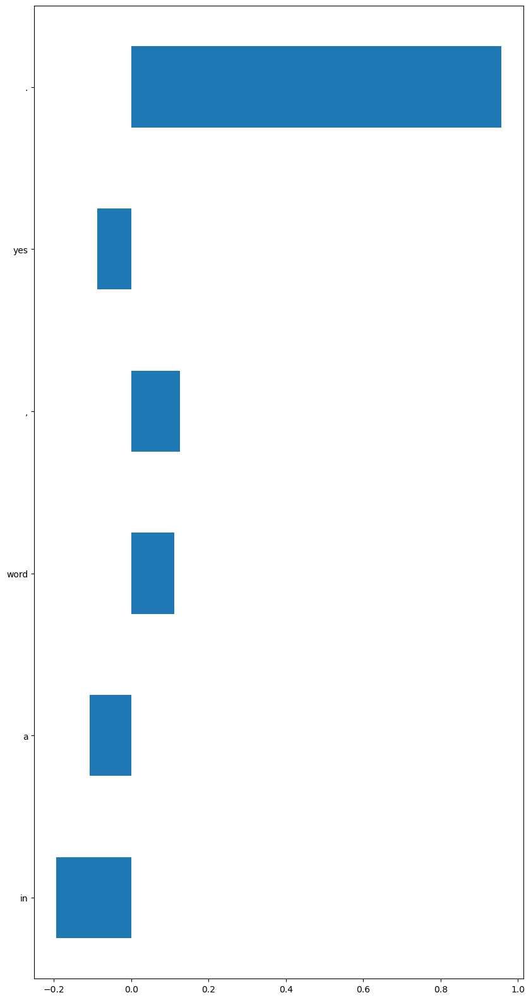

In [11]:
barplot_row(merged_df.iloc[[2]], output='outputs/viz-bert')

## Overall vocabulary & attributions analysis

In [20]:
labels = [
    "alt.atheism",
    "comp.graphics",
    "comp.os.ms-windows.misc",
    "comp.sys.ibm.pc.hardware",
    "comp.sys.mac.hardware",
    "comp.windows.x",
    "misc.forsale",
    "rec.autos",
    "rec.motorcycles",
    "rec.sport.baseball",
    "rec.sport.hockey",
    "sci.crypt",
    "sci.electronics",
    "sci.med",
    "sci.space",
    "soc.religion.christian",
    "talk.politics.guns",
    "talk.politics.mideast",
    "talk.politics.misc",
    "talk.religion.misc"
]

In [21]:
vocab_attributions = dict()
vocab_attributions_by_class = {label: dict() for label in labels}
vocab_counts = dict()
vocab_counts_by_class = dict()

ignore_stopwords = False
merge_subwords = True
aggregate = 'mean'

def dict_entries(token, attribution, by_class=True):
    if token in vocab_attributions:
            vocab_attributions[token].append(attribution)
    else:
        vocab_attributions[token] = [attribution]
    if by_class:
        if token in vocab_attributions_by_class[label]:
            vocab_attributions_by_class[label][token].append(attribution)
        else:
            vocab_attributions_by_class[label][token] = [attribution]


for k, row in filtered_gold.iterrows():
    if type(row['tokens']) == float:
        continue
    assert len(row['attributions']) == len(row['tokens'])
    label = row['label_gold']
    # skip merged tokens
    skip_next_iteration = 0
    # iterate over tokens to save attributions
    for i, token in enumerate(row['tokens']):
        if skip_next_iteration != 0:
            skip_next_iteration -= 1
            continue
        if token:
            word = token
            attribution = row['attributions'][i]
            # detokenize
            if merge_subwords:
                # check whether next token starts with ##
                if i < len(row['tokens'])-1 and row['tokens'][i+1].startswith('##'):
                    # check whether further tokens start with ##
                    to_merge = row['tokens'][i:]
                    count = 1
                    iterator = iter(to_merge[1:])
                    while True:
                        try:
                            token = next(iterator)
                            if token.startswith("##"):
                                count += 1
                            else:
                                break
                        except StopIteration:
                            break
                    to_merge = to_merge[:count]
                    j = len(to_merge)
                    word = ''.join(row['tokens'][i:i+j]).replace('##', '')
                    attr = [row['attributions'][i:i+j]]
                    if aggregate == 'mean':
                        attribution = np.mean(attr)
                    skip_next_iteration = count-1
            # skip stop words
            if ignore_stopwords:
                if word in ENGLISH_STOP_WORDS:
                    continue
            # create or update dict entries with attributions
            dict_entries(word, attribution)

if ignore_stopwords:
    assert set(vocab_attributions.keys()).intersection(ENGLISH_STOP_WORDS) == {}


In [22]:
vocab_attributions_by_class

{'alt.atheism': {'in': [-0.014673215540331483,
   0.020282368072469196,
   0.0037723249445953395,
   -0.0007784380919047091,
   0.003627795083536781,
   -0.010869729333466503,
   -0.0038132509200210045,
   0.0013232067325622562,
   0.010045175127266428,
   0.0024053906083119163,
   -0.017393320780046757,
   0.001658179659296609,
   -0.006834388383996951,
   -0.006753296541948691,
   -0.010119194467888662,
   0.019793226743929884,
   0.0010517365796161907,
   0.01283306302163512,
   -0.0011655310833391984,
   -0.0025201763709489958,
   -0.0016006571393347153,
   0.001970970651237234,
   -0.005875910580064494,
   0.011270577645636406,
   0.019774973300056575,
   0.015451155393220072,
   -0.0016446149140845981,
   0.003053045950656967,
   0.002655909976370474,
   0.12191753705114894,
   0.0017286748880334312,
   0.002594392831215361,
   0.005143115810142569,
   0.0051285997638306725,
   0.0367857931749508,
   0.0073501056732009065,
   0.0125933378427848,
   0.03619783991596115,
   0.05243

In [23]:
average_attr_by_class = {
    label: {
        token: np.mean([a for a in attr if isinstance(a, float)])
        for token, attr in labeldict.items()
    }
    for label, labeldict in vocab_attributions_by_class.items()
}

average_attr_by_class

{'alt.atheism': {'in': 0.0118625822791821,
  'a': 0.021365744377245838,
  'word': 0.06521028223511562,
  ',': 0.01878637680446011,
  'yes': 0.018229383161564045,
  '.': 0.014949119337410603,
  'probably': 0.0063234736920742204,
  'because': 0.010028697402793597,
  'it': 0.007783457940189481,
  'is': 0.015694439917054964,
  'rape': -0.05751891252159579,
  'so': 0.013121677329235986,
  'nothing': 0.011872683801566341,
  'may': -0.0031798175217532735,
  'work': 0.0018414653265675916,
  'for': -0.006808431187344135,
  'some': 0.005728607795875394,
  'but': 0.014357735847432728,
  'not': 0.008638717441938094,
  'others': 0.014010324507668391,
  ':': 0.021900375188029585,
  'doesn': 0.01476586188728687,
  "'": 0.018890608253025885,
  't': 0.004826189241278122,
  'give': -0.007804190252093573,
  'any': 0.012633874145024747,
  'insight': -0.01784263173136561,
  'into': 0.004225833329725268,
  'an': 0.014446027203490124,
  'overall': -0.006183678772032228,
  'god': 0.19938609096682644,
  'or': 

In [24]:
def sort_attr_dict(attr_dict):
    return dict(sorted(attr_dict.items(), key=lambda item: item[1], reverse=True))

In [111]:
# check intersections and differences of vocabs by class
len(set(average_attr_by_class["comp.os.ms-windows.misc"].keys()).intersection(set(average_attr_by_class["alt.atheism"].keys()))), \
len(set(average_attr_by_class["comp.os.ms-windows.misc"].keys()).difference(set(average_attr_by_class["alt.atheism"].keys())))

(2089, 3181)

In [112]:
len(set(average_attr_by_class["rec.motorcycles"].keys()).intersection(set(average_attr_by_class["alt.atheism"].keys()))), \
len(set(average_attr_by_class["rec.motorcycles"].keys()).difference(set(average_attr_by_class["alt.atheism"].keys())))

(2236, 3462)

In [25]:
# sort average attributions for a specific class
sort_attr_dict(average_attr_by_class["alt.atheism"])

{'torah': 0.9340558111433049,
 'walker': 0.7938728681778426,
 'prayer': 0.7054979803456705,
 'heaven': 0.6959299147984109,
 'hebrew': 0.6729315844050558,
 'rabbi': 0.651862445066542,
 'verb': 0.6209632433697962,
 'judaism': 0.6143038439717949,
 'charles': 0.5620048065409862,
 'catholic': 0.5595786711671773,
 'soul': 0.5423753199716101,
 'hemingway': 0.541574952844622,
 'noonan': 0.5251288073113364,
 'italians': 0.5246580943454501,
 'luther': 0.4973820413930348,
 'equivalent': 0.4967356812589924,
 'medieval': 0.47716005422273444,
 'humanism': 0.4573461147674056,
 'christian': 0.4508426703578657,
 'islamic': 0.44497439500218183,
 'cooper': 0.4413515261864065,
 'anarchist': 0.42754204138955004,
 'queens': 0.42668328824330143,
 'demon': 0.42546559232083647,
 'dualism': 0.39790622355231003,
 'totalitarian': 0.39755761438978204,
 'greeks': 0.3961972311060816,
 'artist': 0.38731480991793166,
 'prophetic': 0.3796445925431413,
 'elvis': 0.37469273367394074,
 'hawaii': 0.3733927301134169,
 'athe

In [26]:
# output vocab counts and average attributions, overall and by class
type_list = []
overall_count_list = []
overall_attr_list = []
label_count_lists = {label: [] for label in labels}
label_attr_lists = {label: [] for label in labels}

vocab = set(vocab_attributions.keys())
print(len(vocab))

for v in sorted(vocab):
    type_list.append(v)
    overall_count_list.append(len(vocab_attributions[v]))
    overall_attr_list.append(np.mean(vocab_attributions[v]))
    
    for l in labels:
        if v in vocab_attributions_by_class[l]:
            label_count_lists[l].append(len(vocab_attributions_by_class[l][v]))
            label_attr_lists[l].append(average_attr_by_class[l][v])
        else:
            label_count_lists[l].append(0)
            label_attr_lists[l].append(None)

# Create a DataFrame from the lists
df = pd.DataFrame({
    'type': type_list,
    'overall_count': overall_count_list,
    'overall_attr': overall_attr_list,
    **{f'{label}_count': count_list for label, count_list in label_count_lists.items()},
    **{f'{label}_attr': attr_list for label, attr_list in label_attr_lists.items()}
})

df.to_csv('outputs/vocab_attr_dist4_gold.csv')

43124


## BERT & DistilBERT comparison

- attribution correlations: seems like for short sentences, attributions have higher correlations

In [23]:
# read BERT, processed first 1000 instances only
merged_df_bert = read_dfs(directory='outputs/bert/')
filtered_bert = postprocess(merged_df_bert, whole_ds=False)
len(filtered_bert)

979

In [25]:
# compare to distilbert
filtered_distilbert = filtered.iloc[:len(filtered_bert)]
assert len(filtered_bert) == len(filtered_distilbert)

In [27]:
np.corrcoef(filtered_bert.score, filtered_distilbert.score)

array([[1.        , 0.81367961],
       [0.81367961, 1.        ]])

In [30]:
np.corrcoef(filtered_bert.sum_attributions, filtered_distilbert.sum_attributions)

array([[1.        , 0.61729644],
       [0.61729644, 1.        ]])

In [31]:
np.corrcoef(filtered_bert.correct, filtered_distilbert.correct)

array([[1.       , 0.7655295],
       [0.7655295, 1.       ]])

In [36]:
# https://numpy.org/doc/stable/reference/generated/numpy.corrcoef.html#numpy-corrcoef
# Pearson correlation coefficients, range between -1 and 1

def compare_attributions(index):
    b = filtered_bert.iloc[index].attributions
    d = filtered_distilbert.iloc[index].attributions
    return np.corrcoef(b, d)

In [40]:
compare_attributions(0), compare_attributions(1), compare_attributions(2)

(array([[1.        , 0.49748536],
        [0.49748536, 1.        ]]),
 array([[1.        , 0.77096063],
        [0.77096063, 1.        ]]),
 array([[ 1.        , -0.69978487],
        [-0.69978487,  1.        ]]))

In [45]:
# mean correlations
correls = [compare_attributions(i)[0][1] for i in range(len(filtered_bert))]
np.mean(correls), min(correls), max(correls)

(0.5401232644432448, -0.8187199760933165, 0.9989402788139583)

In [48]:
index_min = correls.index(min(correls))
filtered_bert.iloc[index_min].tokens, len(filtered_bert.iloc[index_min].tokens)

(['it',
  'is',
  'easy',
  'for',
  'sen',
  '.',
  'bid',
  '##en',
  'to',
  'say',
  'that',
  'when',
  'there',
  'are',
  'no',
  'us',
  'troops',
  'in',
  'ze',
  '##pa',
  'or',
  'sr',
  '##eb',
  '##ini',
  '##ca',
  'or',
  'sar',
  '##ej',
  '##ev',
  '##o',
  '.',
  '.',
  '.',
  'the',
  'existing',
  'un',
  'policy',
  'may',
  'certain',
  '##ing',
  'be',
  'wrong',
  ',',
  'but',
  'the',
  'us',
  'wants',
  'to',
  'di',
  '##cta',
  '##te',
  'policy',
  ',',
  'and',
  'make',
  'europe',
  'responsible',
  'for',
  'the',
  'consequences',
  'of',
  'that',
  'policy',
  '.',
  '.',
  '.',
  '.',
  '.',
  '.',
  'bosnia',
  'is',
  'a',
  'big',
  'enough',
  'problem',
  'for',
  'the',
  'us',
  'to',
  'preach',
  'about',
  'what',
  'other',
  'countries',
  'should',
  'be',
  'doing',
  'with',
  'their',
  'forces',
  '.',
  '.',
  '.',
  'but',
  'its',
  'forces',
  'are',
  'safely',
  'tucked',
  'away',
  'at',
  'home',
  'in',
  'the',
  'us',

In [49]:
index_max = correls.index(max(correls))
filtered_bert.iloc[index_max].tokens, len(filtered_bert.iloc[index_max].tokens)

(['not', 'this', 'again', '.'], 4)